Proyek NLP-Indah Dwi Sulistiyawati
dsindah87@students.unnes.ac.id


sumber dataset : https://www.kaggle.com/lokkagle/movie-genre-data

###Klasifikasi Genre Film Multikelas dengan LSTM

In [3]:
#Import library yang akan digunakan
import pandas as pd
import re


#split data
from sklearn.model_selection import train_test_split

#preprocessing dan layer
import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import LSTM,Dense,Embedding,Dropout
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam

#plotting visualisasi
import matplotlib.pyplot as plt

In [4]:
#upload dataet
from google.colab import files
files.upload()

Saving kaggle_movie_train.csv to kaggle_movie_train.csv


{'kaggle_movie_train.csv': b'id,text,genre\n0,"eady dead, maybe even wishing he was. INT. 2ND FLOOR HALLWAY THREE NIGHT The Orderly leads Liza to a door. ORDERLY In here. White guy in his 30s. He opens the door and they step into... ROOM THREE There\'s a white guy in his mid 30s. He looks up. Wild. Straight jacketed. Not Jerry. Liza\'s reached the end of her rope. She just shakes her head. INT. DECREPIT HOSPITAL ROOM NIGHT Balled up. Fetal. Not really all there. Head pressed to the cement, he tries to sing to himself. JERRY Blue moon... Blue moon... INT. 2ND FLOOR HALLWAY THREE NIGHT Liza just stands there, leaning on a rail on the wall. The Orderly isn\'t sure what\'s going on, but he knows it\'s bad. ORDERLY You okay? Liza starts down the hall with the Orderly following. ORDERLY We got some new patients last week. You want to see them? Liza waves them off. It\'s hopeless. She stops at a chicken wired window at the end of the hall, looks out. Light\'s about to break and Jerry\'s out t

In [5]:
#baca dan menampilkan 5 data teratas
df = pd.read_csv("kaggle_movie_train.csv")
df.head()

,id,text,genre
0,0,"eady dead, maybe even wishing he was. INT. 2ND...",thriller
1,2,"t, summa cum laude and all. And I'm about to l...",comedy
2,3,"up Come, I have a surprise.... She takes him ...",drama
3,4,ded by the two detectives. INT. JEFF'S APARTME...,thriller
4,5,"nd dismounts, just as the other children reach...",drama


In [6]:
df.tail()

,id,text,genre
22574,28161,n in the world to decide what I'm going to do ...,drama
22575,28162,shards. BOJO LAZ! Laz pushes Deke back through...,drama
22576,28163,"OTTIE You've got a thing about Ernie's, haven'...",thriller
22577,28165,....with marked skill and dexterity . LANA wry...,action
22578,28166,"rd walks off down the hallway, leaving his pos...",comedy


In [7]:
#cek jumlah value setiap genre
df['genre'].value_counts()

drama        8873
thriller     6824
comedy       2941
action       2392
sci-fi        613
horror        456
other         270
adventure     147
romance        63
Name: genre, dtype: int64

In [8]:
#akan digunakan genre comedy action horror dan romance
#Menghapus genre selain genre tersebut
df = df[~df['genre'].isin(['drama','thriller','other','sci-fi','adventure'])]
df['genre'].value_counts()

comedy     2941
action     2392
horror      456
romance      63
Name: genre, dtype: int64

In [9]:
#akan dihapus karakter spesial di kolom text
df['Text'] = df['text'].map(lambda x: re.sub(r'\W+', ' ', x))
#akan didrop kolom id dan text lama
df = df.drop(['id', 'text'], axis=1)
df.head()

,genre,Text
1,comedy,t summa cum laude and all And I m about to lau...
9,action,e reels as the world spins Sweat pours off him...
20,comedy,I say he s a man who ll go far Some people sa...
25,comedy,you find out where the bachelor party is COLE ...
29,comedy,ibly horrendous public break up on the quad Ag...


In [10]:
#cek nilai kosong (true jika ada dan false jika tidak ada)
df.isnull().values.any()

False

In [11]:
#pelabelan 
genre = pd.get_dummies(df.genre)
df_genre = pd.concat([df, genre], axis=1)
df_genre = df_genre.drop(columns='genre')
df_genre.head()

,Text,action,comedy,horror,romance
1,t summa cum laude and all And I m about to lau...,0,1,0,0
9,e reels as the world spins Sweat pours off him...,1,0,0,0
20,I say he s a man who ll go far Some people sa...,0,1,0,0
25,you find out where the bachelor party is COLE ...,0,1,0,0
29,ibly horrendous public break up on the quad Ag...,0,1,0,0


In [13]:
#ubah tipe data jadi str dan numpy array 
text = df_genre['Text'].astype(str)
label = df_genre[['action', 'comedy','horror','romance']].values

In [14]:
#split
genre_train, genre_test, label_train, label_test = train_test_split(text, label, test_size = 0.2)

In [15]:
#penggunaan tokenizer
tokenizer = Tokenizer(num_words=5000, oov_token='x')
tokenizer.fit_on_texts(genre_train) 
tokenizer.fit_on_texts(genre_test)
 
sekuens_train = tokenizer.texts_to_sequences(genre_train)
sekuens_test = tokenizer.texts_to_sequences(genre_test)
 
padded_train = pad_sequences(sekuens_train) 
padded_test = pad_sequences(sekuens_test)

In [16]:
#memodelkan Sequential menggunakan Embedding dan LSTM
model = Sequential([
    Embedding(input_dim=5000, output_dim=16),
    LSTM(64),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(4, activation='softmax')
])

In [17]:
#compile model dengan adm optimizer
Adam(learning_rate=0.00146, name='Adam')
model.compile(optimizer = 'Adam',
              loss = 'categorical_crossentropy',
              metrics = ['accuracy'])

In [18]:
#penggunakan callback untuk akurasi dan val akurasi diatas 90%
class myCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs={}):
    if(logs.get('accuracy')>0.9 and logs.get('val_accuracy')>0.9):
      print("\nAkurasi train dan validasi telah mencapai target > 90%!")
      self.model.stop_training = True
callbacks = myCallback()

In [19]:
#training model
history = model.fit(padded_train, 
                    label_train, 
                    epochs=30, 
                    validation_data=(padded_test, label_test), 
                    verbose=2, 
                    callbacks=[callbacks])

Epoch 1/30
147/147 - 20s - loss: 1.0272 - accuracy: 0.4736 - val_loss: 0.9842 - val_accuracy: 0.4705
Epoch 2/30
147/147 - 18s - loss: 0.8893 - accuracy: 0.5499 - val_loss: 0.9301 - val_accuracy: 0.5551
Epoch 3/30
147/147 - 17s - loss: 0.6199 - accuracy: 0.7280 - val_loss: 0.5802 - val_accuracy: 0.7933
Epoch 4/30
147/147 - 18s - loss: 0.3487 - accuracy: 0.8889 - val_loss: 0.4400 - val_accuracy: 0.8617
Epoch 5/30
147/147 - 18s - loss: 0.1951 - accuracy: 0.9413 - val_loss: 0.3682 - val_accuracy: 0.8898
Epoch 6/30
147/147 - 18s - loss: 0.1115 - accuracy: 0.9690 - val_loss: 0.3235 - val_accuracy: 0.9129

Akurasi train dan validasi telah mencapai target > 90%!


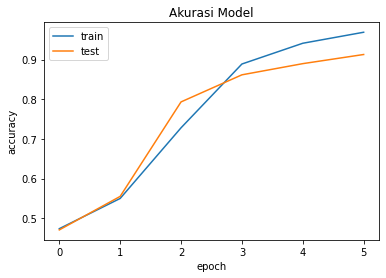

In [20]:
#plotting Accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Akurasi Model')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

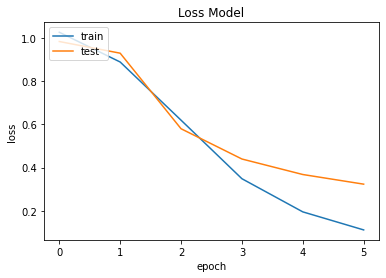

In [21]:
#plotting Loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Loss Model')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()